# StandarGAN - Image harmonization with CycleGANs 
Written by Vincent Jaouen, LaTIM, IMT Atlantique, Brest, France 


For any help with the execution of this code, please contact at vincent.jaouen@imt-atlantique.fr

## README
- Requires MONAI generative library (has to be added for  versions of MONAI earlier than v1.3)
- Method : we use a short unpaired training between two unmatched sets
1. SRC : the source set, typically composed of a few 2D slices, a domain shifted heterogeneous dataset
2. TGT : the target set, typically composed of a unique 2D slice, the desired target appearance

We perform short unpaired (cyclegan) training between SRC and TGT to learn a Generator $G_{AB}$ from SRC to TGT.

The main parameter is the number of epochs.
This has to be optimized (mind overfitting to the target). 
To reduce overfitting, an edge preserving loss is used to preserve the edge content of the initial image.

The example here use a 2D dataset consisting only of the 80$^{\text{th}}$ slice of each image of the BraTS 2023 dataset available on synapse.org

To further examplify the effect of standardization, here the target set is a brainweb phantom slice, which is synthetic with exaggerated GM/WM/CSF contrast. 

If you encounter too much artefacts to your taste, consider using 

- another more reasonable reference
- another generator, as MONAI's UNet uses transpose conv in the decoding path, which is known to produce checkered artefacts. A workaround is to replace TransposeConv by bilinear upsampling.

Main parameters are :
- number of epochs, as we will almost inevitably overfit to the target if we wait too much
- magnitude of the NGF recall force $\lambda_{NGF}$. If low, then image structure will likely worsen quickly. This was addressed in our conference paper by performing another (paired) image-to-image translation after a short CycleGN
- number of res blocks of the $G$s
- number of features num_filters_d of the $D$s

The code is very readily extensible to 3D (just replace 2D by 3D convs/transposeconvs), mind the computational cost though (work with patches)



In [1]:
import nibabel as nib
import os, glob

import matplotlib.pyplot as plt
import numpy as np
import torch

from monai.config import print_config
from monai.data import DataLoader, Dataset, CacheDataset, PatchDataset
from monai.inferers import SliceInferer
from monai.utils import set_determinism, first
from monai.transforms import(
    Compose,
    Lambdad,
    LoadImaged,
    EnsureChannelFirstd,
    SqueezeDimd, 
    RandSpatialCropSamplesd, 
    ScaleIntensityRangePercentilesd, 
    Resized,
    CropForegroundd, 
    CenterSpatialCropd, 
    RandZoomd
)
# print_config()
from datetime import date
today = str(date.today()).replace('-','').replace(' ', '')
gpu_device = torch.device(f'cuda:{0}')


### Options

In [2]:
class Options():
    def __init__(self):
        self.in_channels = 1  # Adjust according to your input image channel dimensions
        self.out_channels = 1  # Adjust according to your output image channel dimensions
        self.num_filters_d = 128  # Adjust the number of filters in the discriminator
        self.lambda_gan = 1 # Adjust the weight for the cycle consistency loss
        self.lambda_identity = 1  # Adjust the weight for the identity loss
        self.lambda_cyc=1
        self.lambda_ngf=100
        self.num_epochs=200
        self.learning_rate = 2e-4  # typical value for CycleGAN

opt=Options()

## Dataset definition, here BraTS 23
We take N random images from the dataset as sources to learn a mapping from, towards a reference image.
Here, the reference is a slice of the BrainWeb phantom, realigned to the BraTS template space.

In [3]:
where_is_BraTS2D ='./data/ASNR-MICCAI-BraTS2023-GLI-Challenge-TrainingData_s080'
where_is_brainweb = './data/MRI_brainweb_to_BraTS_s080.nii.gz'
fnames_A = sorted(glob.glob(where_is_BraTS2D+'/*.nii.gz'))
np.random.seed(29100) # postcode of a beautiful place, won't work if it is not.
np.random.shuffle(fnames_A)
fnames_A = fnames_A[:30]
fnames_B = [where_is_brainweb for i in range(len(fnames_A))]
train_dic = [{"SRC": img1, "TGT": img2 } for (img1,img2) in zip(fnames_A, fnames_B)]

## Transforms

###  Volume processing

In [ ]:
from monai.transforms import Compose, Transform
class AddMaskTransform(Transform):
    def __call__(self, data):
        SRC = data['SRC']
        MASK = (SRC > -1).astype(float)
        data['MASK'] = MASK
        return data
    
train_transforms = Compose(
    [
        LoadImaged(keys=["SRC", "TGT"]),
        EnsureChannelFirstd(keys=["SRC", "TGT"]),
        CropForegroundd(keys=["SRC", "TGT"], source_key="SRC"),
        ScaleIntensityRangePercentilesd(keys=["SRC", "TGT"], lower=1, upper=99, b_min=-1,b_max=1, clip=True),
        Resized(keys=["SRC", "TGT"], spatial_size=[256,256,-1], mode="trilinear"), # make it 256**2 to make sure we downsample correctly
        SqueezeDimd(keys=["SRC", "TGT"], dim=3),
        AddMaskTransform(),
    ]
)
BATCH_SIZE = 1
NUM_WORKERS = 1

train_ds = CacheDataset(train_dic, train_transforms, num_workers=NUM_WORKERS)
train_loader = DataLoader(train_ds, batch_size=BATCH_SIZE, shuffle=True, num_workers=NUM_WORKERS)

first patch's shape:  torch.Size([1, 1, 256, 256])


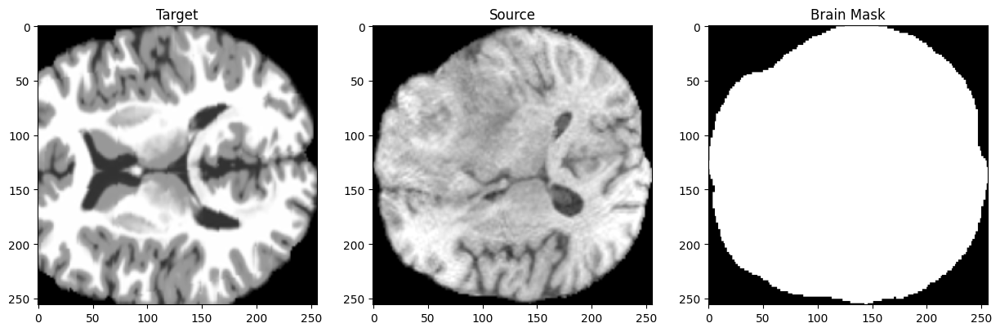

In [5]:
check_data = first(train_loader)
check_data["TGT"].shape
print("first patch's shape: ", check_data["SRC"].shape)
plt.figure(figsize=(15,15))
plt.subplot(1,3,1)
plt.imshow(check_data["TGT"][0,0,:,:].detach().cpu().numpy().squeeze(), cmap="gray")
plt.title('Target')
plt.subplot(1,3,2)
plt.imshow(check_data["SRC"][0,0,:,:].detach().cpu().numpy().squeeze(), cmap="gray")
plt.title('Source')
plt.subplot(1,3,3)
plt.imshow(check_data["MASK"][0,0,:,:].detach().cpu().numpy().squeeze(), cmap="gray")
plt.title('Brain Mask')
plt.show()

In [6]:
from vjnetworks import CycleGAN

In [7]:
import torch.optim


cyclegan_model = CycleGAN(
    in_channels=opt.in_channels,
    out_channels=opt.out_channels,
    num_filters_d=opt.num_filters_d,
    lambda_cyc=opt.lambda_cyc,
    lambda_gan=opt.lambda_gan,
    lambda_identity=opt.lambda_identity
)
optimizer = torch.optim.Adam(cyclegan_model.parameters(), lr=opt.learning_rate)

# Training

Epoch [0/200]: 100%|████████████████████████████| 30/30 [00:08<00:00,  3.37it/s]


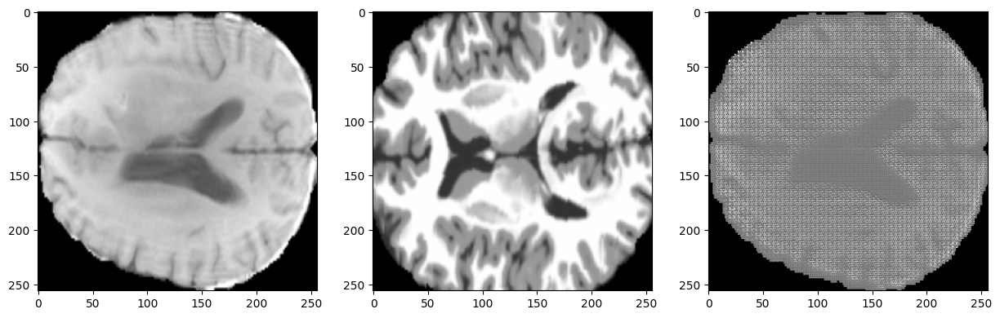

Epoch [10/200]: 100%|███████████████████████████| 30/30 [00:08<00:00,  3.58it/s]


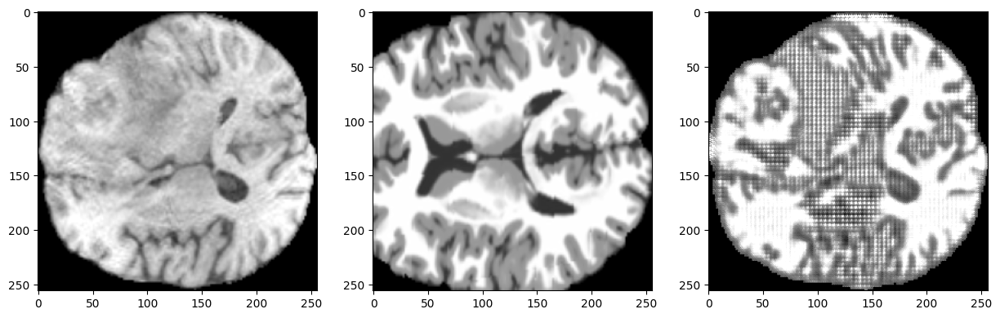

Epoch [20/200]: 100%|███████████████████████████| 30/30 [00:08<00:00,  3.55it/s]


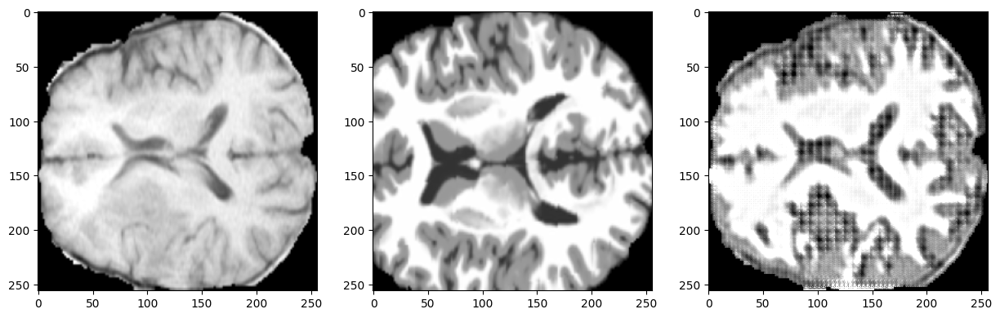

Epoch [30/200]: 100%|███████████████████████████| 30/30 [00:08<00:00,  3.62it/s]


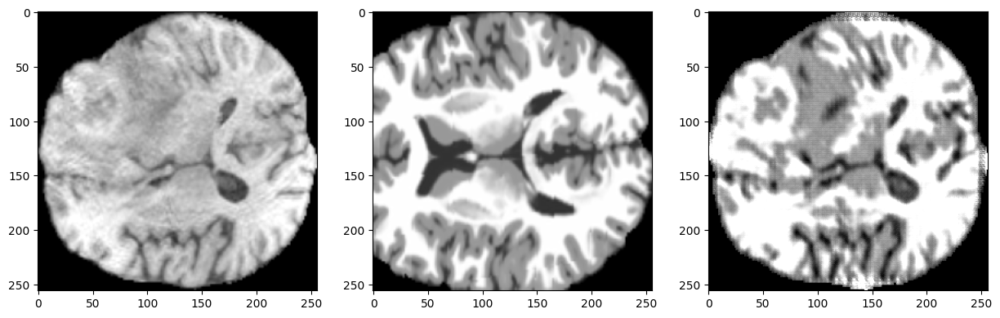

Epoch [40/200]: 100%|███████████████████████████| 30/30 [00:08<00:00,  3.50it/s]


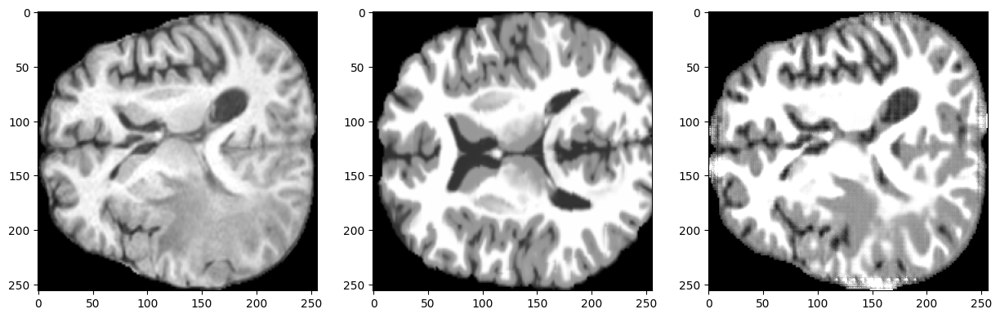

Epoch [50/200]: 100%|███████████████████████████| 30/30 [00:08<00:00,  3.55it/s]


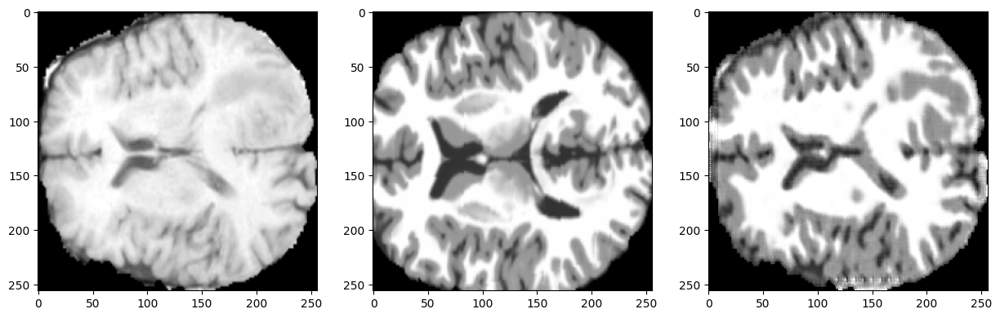

Epoch [60/200]: 100%|███████████████████████████| 30/30 [00:08<00:00,  3.65it/s]


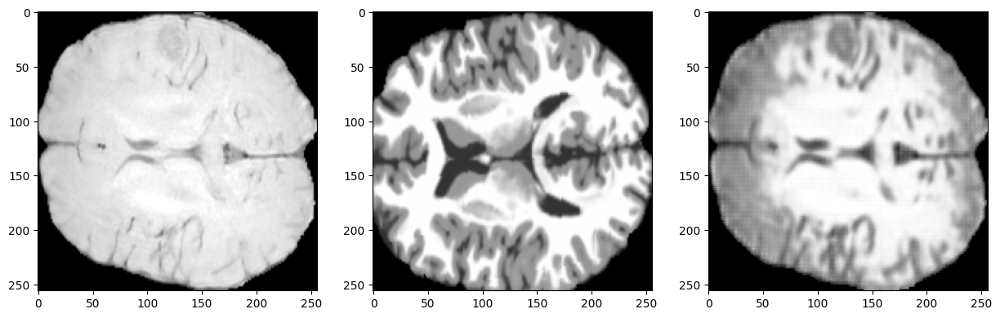

Epoch [70/200]: 100%|███████████████████████████| 30/30 [00:08<00:00,  3.69it/s]


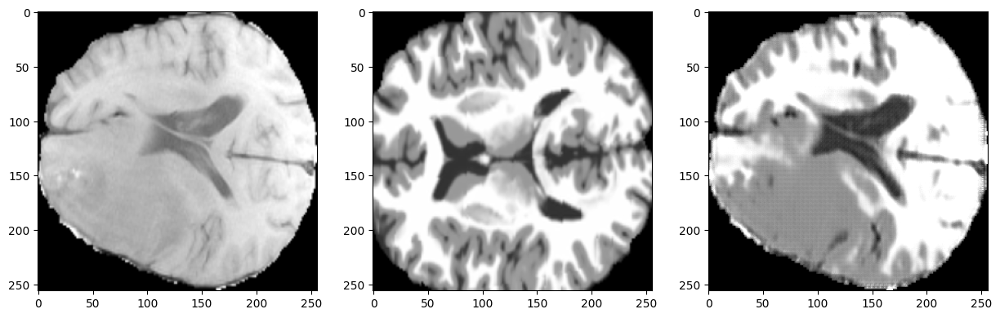

Epoch [80/200]: 100%|███████████████████████████| 30/30 [00:08<00:00,  3.67it/s]


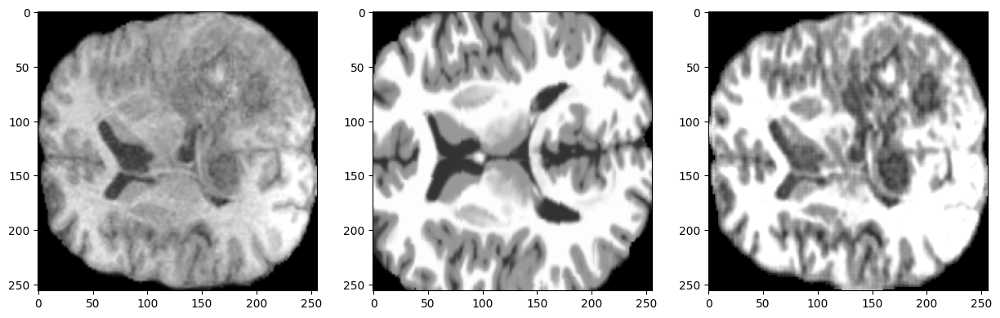

Epoch [90/200]: 100%|███████████████████████████| 30/30 [00:08<00:00,  3.63it/s]


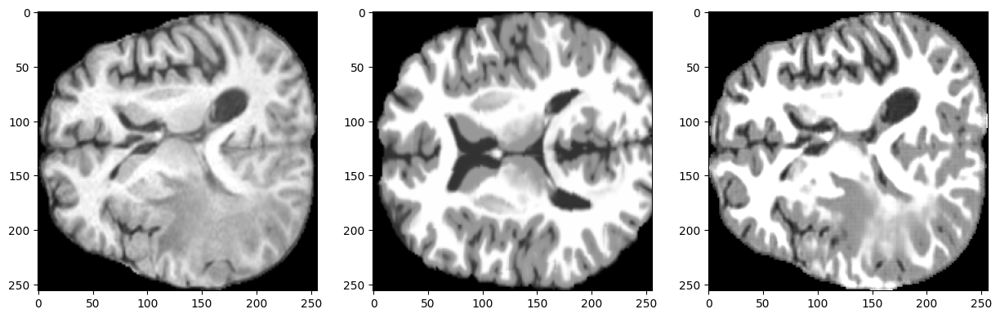

Epoch [100/200]: 100%|██████████████████████████| 30/30 [00:08<00:00,  3.59it/s]


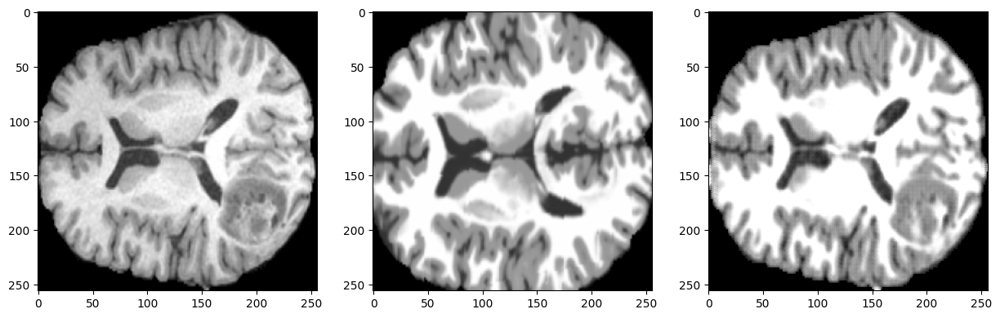

Epoch [110/200]: 100%|██████████████████████████| 30/30 [00:08<00:00,  3.67it/s]


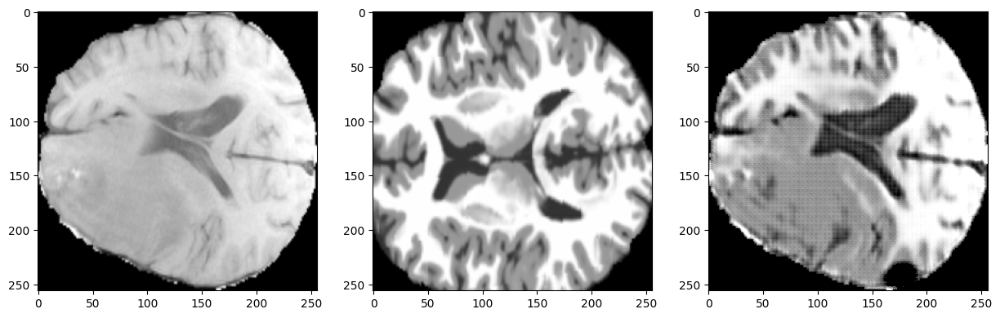

Epoch [120/200]: 100%|██████████████████████████| 30/30 [00:08<00:00,  3.56it/s]


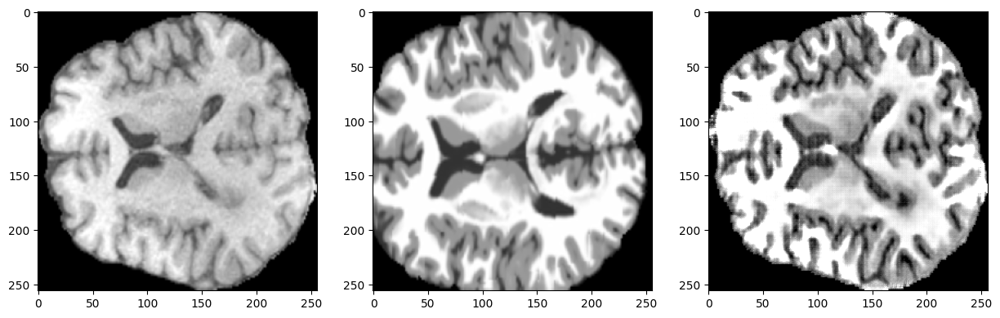

Epoch [130/200]: 100%|██████████████████████████| 30/30 [00:08<00:00,  3.69it/s]


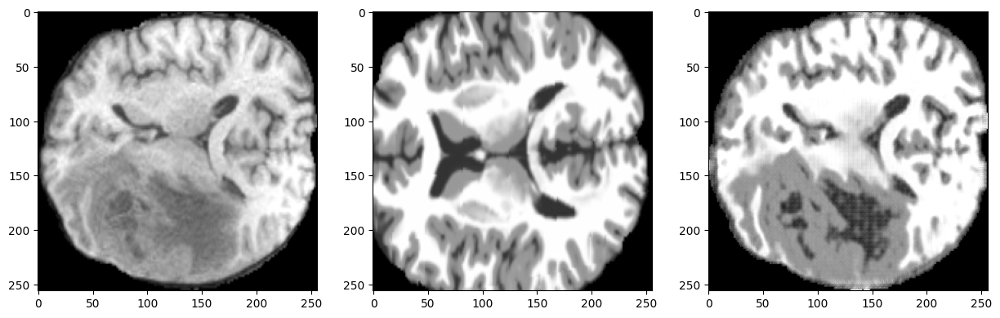

Epoch [140/200]: 100%|██████████████████████████| 30/30 [00:08<00:00,  3.66it/s]


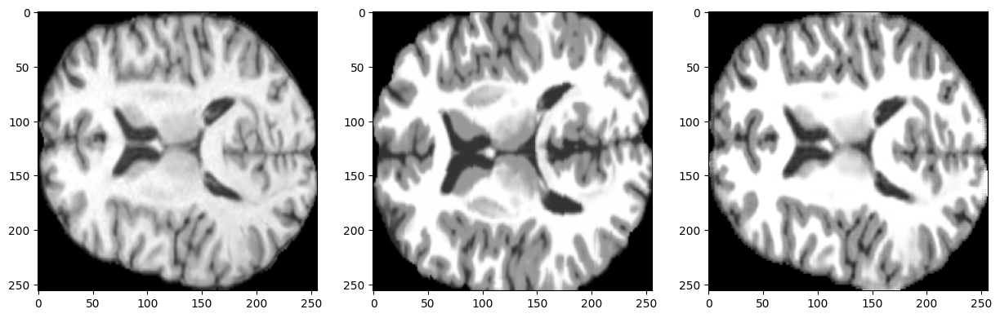

Epoch [150/200]: 100%|██████████████████████████| 30/30 [00:08<00:00,  3.57it/s]


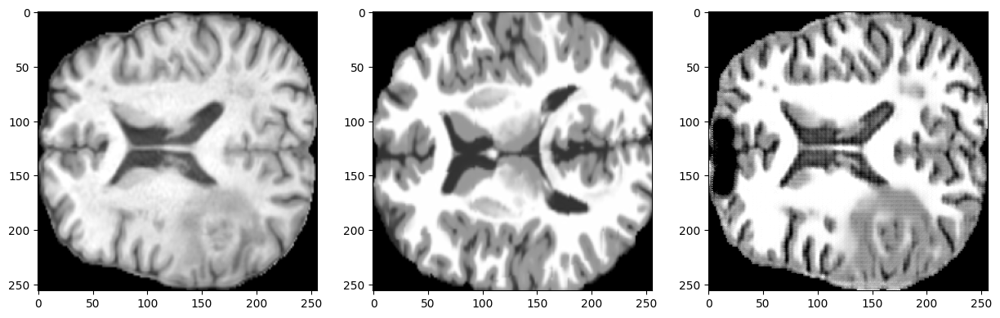

Epoch [160/200]: 100%|██████████████████████████| 30/30 [00:08<00:00,  3.57it/s]


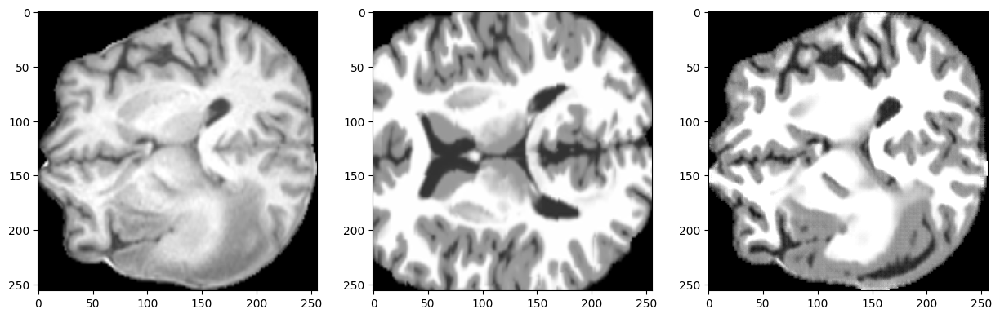

Epoch [170/200]: 100%|██████████████████████████| 30/30 [00:08<00:00,  3.64it/s]


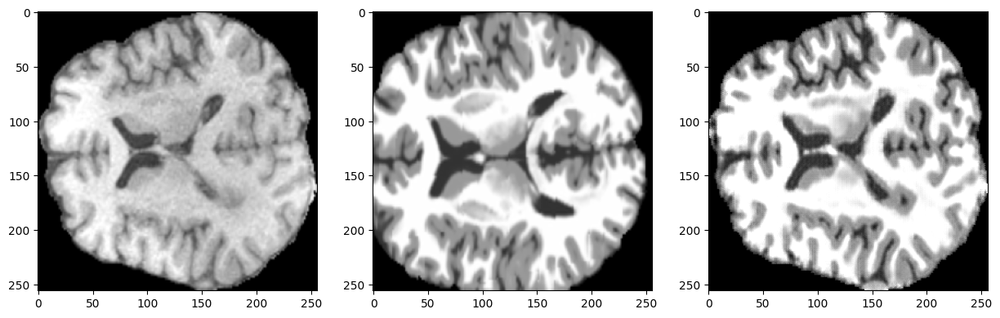

Epoch [180/200]: 100%|██████████████████████████| 30/30 [00:08<00:00,  3.70it/s]


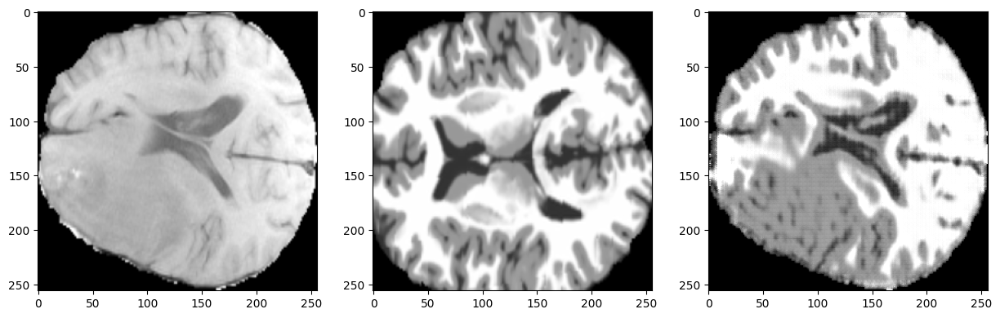

Epoch [190/200]: 100%|██████████████████████████| 30/30 [00:08<00:00,  3.67it/s]


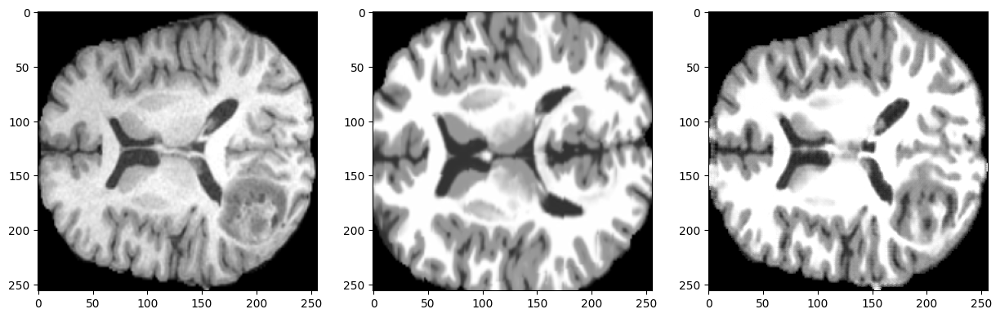

Epoch [200/200]: 100%|██████████████████████████| 30/30 [00:08<00:00,  3.72it/s]


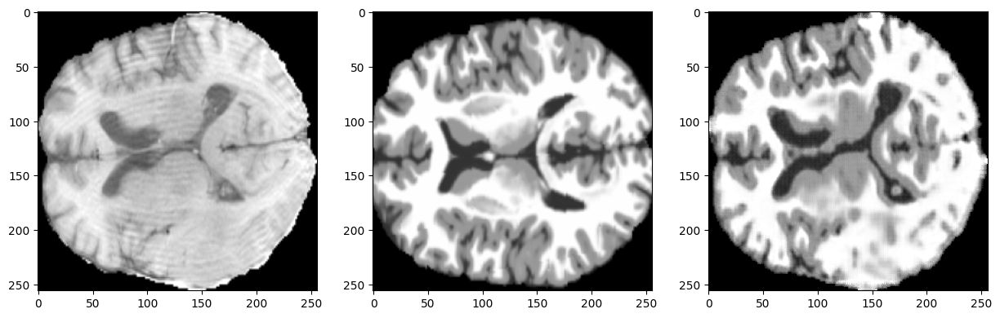

In [8]:
from tqdm import tqdm
for epoch in range(opt.num_epochs+1):
    loop = tqdm(train_loader)
    loop.set_description(f"Epoch [{epoch}/{opt.num_epochs}]")
    for batch_idx, real in enumerate(loop):
        # Transfer data to the device (CPU or GPU)
        real_A = real["SRC"].to(gpu_device)
        real_B = real["TGT"].to(gpu_device)
        mask_A = real['MASK'].to(gpu_device)
        mask_A_bool = mask_A == 0
        # Forward pass
        fake_B, identity_B, pred_fake_B, fake_A, identity_A, pred_fake_A, cyc_B, cyc_A   = cyclegan_model(real_A, real_B, is_training=True)
        
        # this is to ensure that values in the bg will be -1
        negative_ones = torch.full_like(fake_B, -1)
        fake_B_mod = torch.where(mask_A_bool, negative_ones, fake_B)

        cyc_loss_B, identity_loss_B, adv_loss_B, cyc_loss_A, identity_loss_A, adv_loss_A, edge_loss  = cyclegan_model.compute_generator_loss(fake_B_mod, real_B, fake_A, real_A, cyc_B, cyc_A)
         
        generator_loss = (
            cyc_loss_B * opt.lambda_cyc
            + adv_loss_B * opt.lambda_gan
            + identity_loss_B * opt.lambda_identity 
            + cyc_loss_A * opt.lambda_cyc
            + adv_loss_A * opt.lambda_gan
            + identity_loss_A * opt.lambda_identity
            + edge_loss * opt.lambda_ngf
        )              
        discriminator_loss = cyclegan_model.compute_discriminator_loss(real_B, fake_B_mod, real_A, fake_A)
        
        # Backpropagation and optimization
        optimizer.zero_grad()
        generator_loss.backward()
        discriminator_loss.backward()
        optimizer.step()     
        
            
    if epoch%10==0:
        plt.figure(figsize=(15,5))
        plt.subplot(1,3,1)
        plt.imshow(real_A[0,0,:,:,].cpu().detach().numpy().squeeze(), vmin=-1, vmax=1, cmap="gray")
        plt.subplot(1,3,2)
        plt.imshow(real_B[0,0,:,:,].cpu().detach().numpy().squeeze(), vmin=-1, vmax=1, cmap="gray")
        plt.subplot(1,3,3)
        plt.imshow(fake_B_mod[0,0,:,:,].cpu().detach().numpy().squeeze(), vmin=-1, vmax=1, cmap="gray")
        plt.show()
    if epoch%100==0:
        outdir='./weights'
        os.makedirs(outdir, exist_ok=True)
        torch.save({'model': cyclegan_model.state_dict()}, outdir+('/StandarGAN_CYC_UNet256_GAN%d_%s_%.3d.h5' % (opt.lambda_gan, today, epoch)))

See for instance how nicely the thalamus is recovered in this last iteration and how we got rid of the motion artefacts.
However artefacts also appear and some occipital GM is missing. 


Again most of this is due to the very piecewise constant nature of the target. We should expect reduced effects with a more reasonable choice. Nevertheless such exaggerated target can be considered for e.g. WM/GM segmentation using a model trained on the target, which would likely fail on such a poor quality source.




### Inference + going back to the original BraTS image space

We now take all images for inference to produce the standardized image dataset.
Note that in this example, we only perform inference on the $80^{th}$ slice for demonstration as it is the demo dataset we are providing. 
Naturally, we can also perform a slice inference on 3D volumes, by changing the dataloader to load the 3D images (the full BraTS dataset is available on synapse.org)

In [10]:
# now we take all images for inference to produce the standardized dataset
# we 
fnames_A = sorted(glob.glob(where_is_BraTS2D+'/*.nii.gz'))
fnames_B = [where_is_brainweb for i in range(len(fnames_A))]
val_dic = [{"SRC": img1, "TGT": img2 } for (img1,img2) in zip(fnames_A, fnames_B)]

In [12]:
val_transforms = Compose(
    [
        LoadImaged(keys=["SRC", "TGT"]),
        EnsureChannelFirstd(keys=["SRC", "TGT"]),
        CropForegroundd(keys=["SRC", "TGT"], source_key="SRC"),
        ScaleIntensityRangePercentilesd(keys=["SRC", "TGT"], lower=1, upper=99, b_min=-1,b_max=1, clip=True),
        Resized(keys=["SRC", "TGT"], spatial_size=[256,256,-1], mode="trilinear"), # make it 256**2 to make sure we downsample correctly
        AddMaskTransform(),
    ]
)
from monai.transforms import Invertd
post_transforms = Compose(
    [
        Invertd(
        keys=['PRED'],
        transform=val_transforms, 
        orig_keys="SRC"
        )
    ]
)

BATCH_SIZE = 1
NUM_WORKERS = 4

val_ds_fullsize = CacheDataset(val_dic, val_transforms, num_workers=NUM_WORKERS)
val_loader_fullsize = DataLoader(val_ds_fullsize, batch_size=BATCH_SIZE, shuffle=False, num_workers=NUM_WORKERS)

num_samples = 1

Loading dataset: 100%|██████████████████████| 1251/1251 [00:15<00:00, 82.89it/s]


### Slice Inference

In [ ]:
from monai.data.utils import decollate_batch
# inference 
ROI_SIZE=256
model=cyclegan_model.G_AB
model.eval()
outdir=where_is_BraTS2D+'_StandarGAN_'+today
os.makedirs(outdir, exist_ok=True)
with torch.no_grad():
    for i,val_data in enumerate(val_loader_fullsize):
        fname = val_dic[i]['SRC']
        nii = nib.load(fname)
        img = nii.get_fdata()
        
        val_images =val_data["SRC"].to(gpu_device)
        
        roi_size = (ROI_SIZE,ROI_SIZE)
        sw_batch_size=1
        slice_inferer = SliceInferer(
            roi_size=roi_size,
            sw_batch_size=sw_batch_size,
            overlap=0.5,
            mode='constant',
            sigma_scale=0., # use if mode="gaussian"
            spatial_dim=2,  # axial inference
            device=gpu_device,
            padding_mode="replicate",
        )
        val_data["PRED"] = slice_inferer(val_images, model)
        OUT = post_transforms(decollate_batch(val_data))[0]
        
        output = OUT['PRED'].detach().cpu().numpy().squeeze(axis=0)
        # fill background with -1 and clip
        output[np.where(img==0)]=-1
        output[np.where(output<-1)]=-1
        output[np.where(output>1)]=1
        
        # Fake
        fname_out = os.path.join(outdir, val_dic[i]['SRC'].split('/')[-1].split('.')[0]+'_STD.nii.gz')
        nii_out = nib.Nifti1Image(output, None, nii.header)
        nib.save(nii_out, fname_out)
        print(fname_out.split('/')[-1]+',', end='')

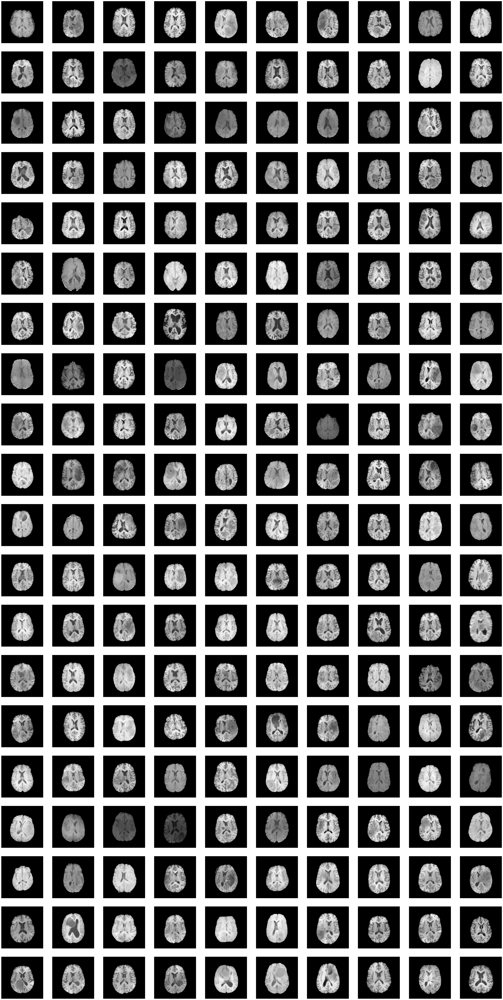

In [40]:
fnames = sorted(os.listdir(where_is_BraTS2D))
np.random.seed(29100)
np.random.shuffle(fnames)
fnames = fnames[:200]
plt.figure(figsize=(50,100))
for i,fname in enumerate(fnames):
    plt.subplot(20,10,i+1)
    img = nib.load(os.path.join(where_is_BraTS2D, fname)).get_fdata()
    plt.imshow(np.rot90(img,3), cmap='gray')
    plt.axis('off')

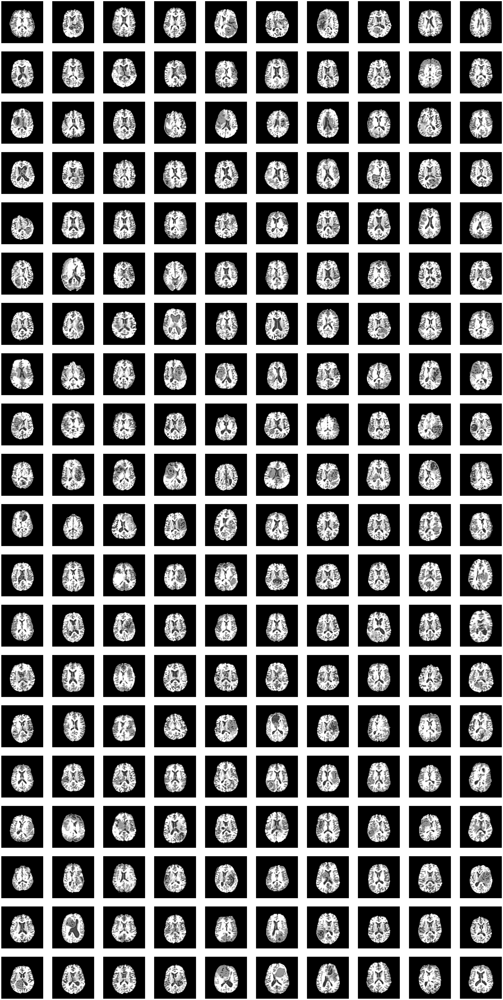

In [41]:
fnames = sorted(os.listdir(outdir))
np.random.seed(29100)
np.random.shuffle(fnames)
fnames = fnames[:200]
plt.figure(figsize=(50,100))
for i,fname in enumerate(fnames):
    plt.subplot(20,10,i+1)
    img = nib.load(os.path.join(outdir, fname)).get_fdata()
    plt.imshow(np.rot90(img,3), vmin=-1, vmax=1, cmap='gray')
    plt.axis('off')